# AniList scraper by Bence

I used chatgpt handily while making this but I tried to spend some effort actually checking everything, removing and fixing stupid stuff it was doing and testing that it's behaving correctly.
The main bottleneck is AniLists rate limiting, currently it's set to 30 requests a minute, and if you keep trying to request when you run out it'll just timeout you for 60s so I made sure to
keep that in check.\
Please read the full guide here, it contains important information on how to tweak download time and how the scraper works.

example usage:
```python
anime_data = fetch_anilist_top_entries(media_limit=5, page=1, max_characters=50, max_staff=50)
```

It has the following arguements you can use:\
(all of them are predefined)
```python
def fetch_anilist_top_entries(
        media_type="ANIME",
        media_limit=50,
        page=1,
        max_characters=25,
        max_staff=25,
        sort=["POPULARITY_DESC"]
    ):
```
**Tip:** you can set `media_limit`, `max_characters`, `max_staff` to -1 to just download everything.

- **media_type**: Type of media to fetch. `"ANIME"` for anime, `"MANGA"` for manga.
- **media_limit**: Total number of media entries to fetch (e.g., 50 for top 50 anime).\
This one spends 1 API request per 50 animes.
- **page**: Starting page number for pagination (default is 1).
- **max_characters**: Maximum number of characters to fetch per media entry.\
This one spends 1 API request per 25 characters.
- **max_staff**: Maximum number of staff members to fetch per media entry.\
This one spends 1 API request per 25 staff.
- **sort**: List of sorting criteria, e.g., `["POPULARITY_DESC"]` for most popular first. See AniList API docs for other options.

## Pagination and API Requests

AniList's API uses pagination for all its queries, meaning you can only fetch a limited number of items per request:

- **Media**: Each request for media (anime/manga) returns up to 50 entries per page. When you fetch more than 50, the `page` parameter is incremented and it makes additional requests.
- **Characters & Staff**: For each media entry, characters and staff are also paginated, with up to 25 entries per request. If a show has more than 25 characters or staff, the code will make multiple requests (incrementing the `page` parameter) until it collects the desired number or there are no more entries.

**API Request Calculation Example:**  
Suppose you want to fetch 200 anime, with up to 50 characters and 25 staff per anime:

- **Media requests:**  
    200 anime / 50 per request = 4 requests

- **Character requests:**  
    Each anime: 50 characters / 25 per request = 2 requests  
    For 200 anime: 2 × 200 = 400 requests

- **Staff requests:**  
    Each anime: 25 staff / 25 per request = 1 request  
    For 200 anime: 1 × 200 = 200 requests

- **Total requests:**  
    4 (media) + 400 (characters) + 200 (staff) = **604 requests**

At 30 requests per minute, this would take about 20 minutes (604 / 30 ≈ 20).  
**Tip:** Lowering `max_characters` and `max_staff` reduces the number of requests drastically.\
There are usually below 100 characters per anime (there are big outliers sometimes like ONE PIECE)\
There are usually between 1000 and 100 staff per anime.

In [37]:
import requests
import time
import re
import datetime
import keyboard
import json
import sys
 
 
# -----------------------------------------------------
#  Helpers
# -----------------------------------------------------
 
API_URL = "https://graphql.anilist.co"
HEADERS = {"Content-Type": "application/json", "Accept": "application/json"}
 
current_filesize = 0
N_collected_media = 0
start_time = datetime.datetime.now()
handle_time = datetime.datetime.now()
from IPython.display import clear_output
 
def update_block(lines):
    clear_output(wait=True)
    print(f"Download started at {start_time.strftime('%Y-%m-%d %H:%M:%S')}") # keep this line
    for line in lines:
        print(line)
 
def graphql_request(query, variables, max_retries=5):
    """Generic POST request with retry on rate-limit."""
    global handle_time
    elapsed = (datetime.datetime.now() - handle_time).total_seconds()
    handle_time = datetime.datetime.now()
    for attempt in range(max_retries):
        resp = requests.post(API_URL, json={"query": query, "variables": variables}, headers=HEADERS)
 
        global current_filesize
        update_block([
            f"Number of anime downloaded: {N_collected_media}",
            f"Current data size: {current_filesize} bytes / {current_filesize / (1024*1024):.2f} MB",
            f"Requests remaining: {resp.headers.get('X-RateLimit-Remaining', 0)}",
            f"Time since last request: {elapsed:.3f}s"
        ])
        time.sleep(1.6) # it almost always takes more than 0.4s to process the request, so wait 1.6s to make it 2s between requests
 
        if resp.status_code == 200:
            return resp.json()
 
        if resp.status_code == 429:
            retry_after = int(resp.headers.get("Retry-After", 10))
            #print(f"Rate limited. Retrying in {retry_after}s…")
            update_block([
                f"Number of anime downloaded: {N_collected_media}",
                f"Current data size: {current_filesize} bytes / {current_filesize / (1024*1024):.2f} MB",
                f"Rate limited. Retrying in {retry_after}s…"
            ])
            time.sleep(retry_after + 1)
            continue
 
        resp.raise_for_status()
 
    raise RuntimeError("Exceeded max retries for AniList API.")
 
 
# -----------------------------------------------------
#  Staff Role Parsing
# -----------------------------------------------------
 
def expand_range(text):
    start, end = map(int, text.split('-'))
    return list(range(start, end + 1))
 
 
def parse_staff_role(role_text):
    base_role = role_text
    episodes = []
    tags = []
 
    m = re.search(r"\((.*?)\)", role_text) # example: Episode director (eps 1-12, 14, 16-18, ED1)
    if m:
        inside = m.group(1).strip()               # gets: eps 1-12, ep 5, 14, 16-18, ED1
        base_role = role_text[:m.start()].strip() # gets: Episode director
 
        parts = [p.strip() for p in inside.split(",")]
 
        for p in parts:
 
            if re.match(r"ep?s?\s*\d+\s*-\s*\d+", p): # matches: eps 1-12
                for r in re.findall(r"\d+-\d+", p):
                    episodes.extend(expand_range(r))  # list <- [1,2,3,...,12]
                continue
 
            if re.match(r"^\d+\s*-\s*\d+$", p):       # matches: 16-18
                episodes.extend(expand_range(p))      # list <- [16,17,18]
                continue
 
            if re.match(r"ep?s?\s*\d+$", p):          # matches: ep 5
                episodes.append(int(re.findall(r"\d+", p)[0]))
                continue
 
            if re.match(r"^\d+$", p):                 # matches: 14
                episodes.append(int(p))
                continue
 
            tags.append(p)                     # anything else is a tag
 
    return {
        "base_role": base_role,
        "episodes": sorted(set(episodes)),
        "tags": tags
    }
 
 
# -----------------------------------------------------
#  Character Description Parsing
# -----------------------------------------------------
 
def split_character_description(character):
    """
    Splits the character's description into 'attributes' (dict) and 'description' (str).
    Attributes are detected by the pattern '__Attribute:__ value\n'.
    Removes markdown links like [text](url) from the description, keeping only 'text'.
    Removes all '\n' from the description.
    Keeps all other fields (like 'name') intact.
    """
    desc = character.get('description', '')
    if not isinstance(desc, str):
        desc = ''
 
    # Remove markdown links: [text](url) -> text
    desc = re.sub(r'\[([^\]]+)\]\([^)]+\)', r'\1', desc)
 
    # Extract attributes
    attributes = {}
    pattern = re.compile(r'__([A-Za-z ]+):__\s*(.*?)\n', re.DOTALL)
    matches = list(pattern.finditer(desc))
    for match in matches:
        key = match.group(1).strip()
        value = match.group(2).strip()
        attributes[key] = value
 
    cleaned_desc = pattern.sub('', desc).strip() # Remove attributes from description
    cleaned_desc = cleaned_desc.replace('\n', ' ')
 
    # change attributes and description while keeping other fields intact
    result = character.copy() 
    result['attributes'] = attributes
    result['description'] = cleaned_desc
    return result
 
# -----------------------------------------------------
#  Queries
# -----------------------------------------------------
 
MEDIA_QUERY = """
query ($type: MediaType, $page: Int, $sort: [MediaSort]) {
    Page(page: $page, perPage: 50) {
        pageInfo { hasNextPage }
        media(type: $type, sort: $sort) {
            id
            title { romaji english native }
            popularity
            averageScore
            episodes
            nextAiringEpisode { episode }
            genres
            tags { name }
            studios { nodes { name } }
            stats { scoreDistribution { score amount } statusDistribution { status amount } }
            startDate { year month day }
            endDate { year month day }
            duration
            description
        }
    }
}
"""
 
STAFF_QUERY = """
query ($mediaId: Int, $page: Int) {
  Media(id: $mediaId) {
    staff(page: $page, perPage:25) {
      pageInfo { hasNextPage }
      edges {
        role
        node { name { full } }
        id
      }
    }
  }
}
"""
 
CHAR_QUERY = """
query ($mediaId: Int, $page: Int) {
  Media(id: $mediaId) {
    characters(page: $page, perPage:25) {
      pageInfo { hasNextPage }
      edges {
        node {
          name { full }
          description
          id
        }
        voiceActors(language: JAPANESE, sort: [RELEVANCE, ID]) {
          name { full }
          id
        }
      }
    }
  }
}
"""
 
 
# -----------------------------------------------------
#  Pagination helpers
# -----------------------------------------------------
data = None
 
def fetch_paginated(query, variables, path, max_results=25):
    """Fetch paginated AniList data under the given JSON path."""
    page = 1
    results = []
 
    while max_results == -1 or len(results) < max_results:
        variables["page"] = page
        data = graphql_request(query, variables)
 
        # dig into nested JSON
        # example: extract data["data"]["Media"]["staff"] from data
        node = data["data"] 
        for p in path:      
            node = node[p]
 
        edges = node["edges"]
        results.extend(edges)
 
        if not node["pageInfo"]["hasNextPage"]:
            break
 
        page += 1
 
    return results
 
 
# -----------------------------------------------------
#  Character & Staff Processing
# -----------------------------------------------------
 
def simplify_character(node_edge):
    node = node_edge["node"]
    jp_va = node_edge.get("voiceActors", [])
    first_va = jp_va[0]["name"]["full"] if jp_va else None
 
    return split_character_description({
        "name": node["name"]["full"],
        "description": node.get("description"),
        "japanese_va": first_va,
        "character_id": node["id"],
        "va_id": jp_va[0]["id"] if jp_va else None
    })
 
 
def simplify_staff(edge):
    name = edge["node"]["name"]["full"]
    role = edge["role"]
    parsed = parse_staff_role(role)
    return {
        "name": name,
        "role": parsed["base_role"],
        "episodes": parsed["episodes"],
        "tags": parsed["tags"],
        "id": edge["id"]
    }
 
 
# -----------------------------------------------------
#  Main scraper
# -----------------------------------------------------
 
def fetch_anilist_top_entries(
        media_type="ANIME",
        media_limit=50,
        page=1,
        max_characters=25,
        max_staff=25,
        sort=["POPULARITY_DESC"]
    ):
 
    global start_time
    start_time = datetime.datetime.now()
    print(f"Download started at {start_time.strftime('%Y-%m-%d %H:%M:%S')}")
 
    global current_filesize
    global N_collected_media
    N_collected_media = 0
    start_page = page
    per_page = 50 # fixed by the MEDIA_QUERY
    collected_media = []
 
    while media_limit == -1 or (page-start_page) * per_page < media_limit:
        variables = {"type": media_type, "page": page, "perPage": per_page, "sort": sort}
        response = graphql_request(MEDIA_QUERY, variables)
 
        data = response["data"]["Page"]
        media_batch = data["media"]
        collected_media.extend(media_batch)
        if not data["pageInfo"]["hasNextPage"]:
            break
 
        page += 1
 
    # Trim to exact media limit
    collected_media = collected_media[:media_limit]
 
    rank = 1 + (start_page - 1) * per_page
    # Fetch characters + staff for each
    for media in collected_media:
        if not keyboard.is_pressed('esc'):
            pass
        else:
            print("\nDownload interrupted by user.")
            break
        media_id = media["id"]
        media["rank"] = rank
        rank += 1
 
        # Staff
        raw_staff = fetch_paginated(STAFF_QUERY, {"mediaId": media_id}, ["Media", "staff"], max_staff)
        simplified_staff = [simplify_staff(edge) for edge in raw_staff]
 
        # Characters
        raw_chars = fetch_paginated(CHAR_QUERY, {"mediaId": media_id}, ["Media", "characters"], max_characters)
        simplified_chars = [simplify_character(edge) for edge in raw_chars]
 
        # Description (remove <br><br>\r\n)
        if "description" in media and isinstance(media["description"], str):
            media["description"] = re.sub(r'<br\s*/?><br\s*/?>\s*', ' ', media["description"]).strip()
        else:
            media["description"] = ""
 
        # Tags
        media["tags"] = [tag["name"] for tag in media.get("tags", [])]
        # Studios
        media["studios"] = [studio["name"] for studio in media.get("studios", {}).get("nodes", [])]
        # next airing episode
        if "nextAiringEpisode" in media and isinstance(media["nextAiringEpisode"], dict):
            media["nextAiringEpisode"] = media["nextAiringEpisode"].get("episode")
        else:
            media["nextAiringEpisode"] = None
 
        media["staff"] = simplified_staff
        media["characters"] = simplified_chars
 
        current_filesize = sys.getsizeof(json.dumps(collected_media))
        N_collected_media += 1
 
        # Debug print
        #print(f"{media['title']['romaji']}: {len(simplified_chars)} chars, {len(simplified_staff)} staff")
 
    collected_media = collected_media[:N_collected_media]
    end_time = datetime.datetime.now()
    print(f"\nDownload completed at {end_time.strftime('%Y-%m-%d %H:%M:%S')}, duration: {end_time - start_time}")
 
    return collected_media

In [ ]:
'''
import requests
import time
import re
import datetime
import keyboard
import json
import sys


# -----------------------------------------------------
#  Helpers
# -----------------------------------------------------

API_URL = "https://graphql.anilist.co"
HEADERS = {"Content-Type": "application/json", "Accept": "application/json"}

requests_sent = 0
current_filesize = 0
N_collected_media = 0
start_time = datetime.datetime.now()

def update_block(lines):
    clear_output(wait=True)
    print(f"Download started at {start_time.strftime('%Y-%m-%d %H:%M:%S')}") # keep this line
    for line in lines:
        print(line)


def graphql_request(query, variables, max_retries=5):
    """Generic POST request with retry on rate-limit."""
    for attempt in range(max_retries):
        resp = requests.post(API_URL, json={"query": query, "variables": variables}, headers=HEADERS)
        global requests_sent
        requests_sent += 1
        #print(f"\rAniList API requests sent: {requests_sent}", end="", flush=True)
        global current_filesize
        update_block([
            f"Number of anime downloaded: {N_collected_media}",
            f"Current data size: {current_filesize} bytes / {current_filesize / (1024*1024):.2f} MB",
            f"Requests remaining: {resp.headers.get('X-RateLimit-Remaining', 0)}"
        ])

        if resp.status_code == 200:
            return resp.json()

        if resp.status_code == 429:
            retry_after = int(resp.headers.get("Retry-After", 10))
            #print(f"Rate limited. Retrying in {retry_after}s…")
            update_block([
                f"Number of anime downloaded: {N_collected_media}",
                f"Current data size: {current_filesize} bytes / {current_filesize / (1024*1024):.2f} MB",
                f"Rate limited. Retrying in {retry_after}s…"
            ])
            time.sleep(retry_after + 1)
            continue

        resp.raise_for_status()

    raise RuntimeError("Exceeded max retries for AniList API.")


# -----------------------------------------------------
#  Staff Role Parsing
# -----------------------------------------------------

def expand_range(text):
    start, end = map(int, text.split('-'))
    return list(range(start, end + 1))


def parse_staff_role(role_text):
    base_role = role_text
    episodes = []
    tags = []

    m = re.search(r"\((.*?)\)", role_text) # example: Episode director (eps 1-12, 14, 16-18, ED1)
    if m:
        inside = m.group(1).strip()               # gets: eps 1-12, ep 5, 14, 16-18, ED1
        base_role = role_text[:m.start()].strip() # gets: Episode director

        parts = [p.strip() for p in inside.split(",")]

        for p in parts:

            if re.match(r"ep?s?\s*\d+\s*-\s*\d+", p): # matches: eps 1-12
                for r in re.findall(r"\d+-\d+", p):
                    episodes.extend(expand_range(r))  # list <- [1,2,3,...,12]
                continue

            if re.match(r"^\d+\s*-\s*\d+$", p):       # matches: 16-18
                episodes.extend(expand_range(p))      # list <- [16,17,18]
                continue

            if re.match(r"ep?s?\s*\d+$", p):          # matches: ep 5
                episodes.append(int(re.findall(r"\d+", p)[0]))
                continue

            if re.match(r"^\d+$", p):                 # matches: 14
                episodes.append(int(p))
                continue

            tags.append(p)                     # anything else is a tag

    return {
        "base_role": base_role,
        "episodes": sorted(set(episodes)),
        "tags": tags
    }


# -----------------------------------------------------
#  Character Description Parsing
# -----------------------------------------------------

def split_character_description(character):
    """
    Splits the character's description into 'attributes' (dict) and 'description' (str).
    Attributes are detected by the pattern '__Attribute:__ value\n'.
    Removes markdown links like [text](url) from the description, keeping only 'text'.
    Removes all '\n' from the description.
    Keeps all other fields (like 'name') intact.
    """
    desc = character.get('description', '')
    if not isinstance(desc, str):
        desc = ''

    # Remove markdown links: [text](url) -> text
    desc = re.sub(r'\[([^\]]+)\]\([^)]+\)', r'\1', desc)

    # Extract attributes
    attributes = {}
    pattern = re.compile(r'__([A-Za-z ]+):__\s*(.*?)\n', re.DOTALL)
    matches = list(pattern.finditer(desc))
    for match in matches:
        key = match.group(1).strip()
        value = match.group(2).strip()
        attributes[key] = value

    cleaned_desc = pattern.sub('', desc).strip() # Remove attributes from description
    cleaned_desc = cleaned_desc.replace('\n', ' ')

    # change attributes and description while keeping other fields intact
    result = character.copy() 
    result['attributes'] = attributes
    result['description'] = cleaned_desc
    return result

# -----------------------------------------------------
#  Queries
# -----------------------------------------------------

MEDIA_QUERY = """
query ($type: MediaType, $page: Int, $sort: [MediaSort]) {
    Page(page: $page, perPage: 50) {
        pageInfo { hasNextPage }
        media(type: $type, sort: $sort) {
            id
            title { romaji english native }
            popularity
            averageScore
            episodes
            nextAiringEpisode { episode }
            genres
            tags { name }
            studios { nodes { name } }
            stats { scoreDistribution { score amount } statusDistribution { status amount } }
            startDate { year month day }
            endDate { year month day }
            duration
            description
        }
    }
}
"""

STAFF_QUERY = """
query ($mediaId: Int, $page: Int) {
  Media(id: $mediaId) {
    staff(page: $page, perPage:25) {
      pageInfo { hasNextPage }
      edges {
        role
        node { name { full } }
        id
      }
    }
  }
}
"""

CHAR_QUERY = """
query ($mediaId: Int, $page: Int) {
  Media(id: $mediaId) {
    characters(page: $page, perPage:25) {
      pageInfo { hasNextPage }
      edges {
        node {
          name { full }
          description
          id
        }
        voiceActors(language: JAPANESE, sort: [RELEVANCE, ID]) {
          name { full }
          id
        }
      }
    }
  }
}
"""


# -----------------------------------------------------
#  Pagination helpers
# -----------------------------------------------------
data = None

def fetch_paginated(query, variables, path, max_results=25):
    """Fetch paginated AniList data under the given JSON path."""
    page = 1
    results = []

    while max_results == -1 or len(results) < max_results:
        variables["page"] = page
        data = graphql_request(query, variables)

        # dig into nested JSON
        # example: extract data["data"]["Media"]["staff"] from data
        node = data["data"] 
        for p in path:      
            node = node[p]

        edges = node["edges"]
        results.extend(edges)

        if not node["pageInfo"]["hasNextPage"]:
            break

        page += 1

    return results


# -----------------------------------------------------
#  Character & Staff Processing
# -----------------------------------------------------

def simplify_character(node_edge):
    node = node_edge["node"]
    jp_va = node_edge.get("voiceActors", [])
    first_va = jp_va[0]["name"]["full"] if jp_va else None

    return split_character_description({
        "name": node["name"]["full"],
        "description": node.get("description"),
        "japanese_va": first_va,
        "character_id": node["id"],
        "va_id": jp_va[0]["id"] if jp_va else None
    })


def simplify_staff(edge):
    name = edge["node"]["name"]["full"]
    role = edge["role"]
    parsed = parse_staff_role(role)
    return {
        "name": name,
        "role": parsed["base_role"],
        "episodes": parsed["episodes"],
        "tags": parsed["tags"],
        "id": edge["id"]
    }


# -----------------------------------------------------
#  Main scraper
# -----------------------------------------------------

def fetch_anilist_top_entries(
        media_type="ANIME",
        media_limit=50,
        page=1,
        max_characters=25,
        max_staff=25,
        sort=["POPULARITY_DESC"]
    ):

    global start_time
    start_time = datetime.datetime.now()
    print(f"Download started at {start_time.strftime('%Y-%m-%d %H:%M:%S')}")

    global requests_sent
    global current_filesize
    global N_collected_media
    N_collected_media = 0
    requests_sent = 0
    start_page = page
    per_page = 50 # fixed by the MEDIA_QUERY
    collected_media = []

    while media_limit == -1 or (page-start_page) * per_page < media_limit:
        variables = {"type": media_type, "page": page, "perPage": per_page, "sort": sort}
        response = graphql_request(MEDIA_QUERY, variables)

        data = response["data"]["Page"]
        media_batch = data["media"]
        collected_media.extend(media_batch)
        if not data["pageInfo"]["hasNextPage"]:
            break

        page += 1

    # Trim to exact media limit
    collected_media = collected_media[:media_limit]

    rank = 1 + (start_page - 1) * per_page
    # Fetch characters + staff for each
    for media in collected_media:
        if not keyboard.is_pressed('esc'):
            pass
        else:
            print("\nDownload interrupted by user.")
            break
        media_id = media["id"]
        media["rank"] = rank
        rank += 1

        # Staff
        raw_staff = fetch_paginated(STAFF_QUERY, {"mediaId": media_id}, ["Media", "staff"], max_staff)
        simplified_staff = [simplify_staff(edge) for edge in raw_staff]

        # Characters
        raw_chars = fetch_paginated(CHAR_QUERY, {"mediaId": media_id}, ["Media", "characters"], max_characters)
        simplified_chars = [simplify_character(edge) for edge in raw_chars]

        # Description (remove <br><br>\r\n)
        if "description" in media and isinstance(media["description"], str):
            media["description"] = re.sub(r'<br\s*/?><br\s*/?>\s*', ' ', media["description"]).strip()
        else:
            media["description"] = ""

        # Tags
        media["tags"] = [tag["name"] for tag in media.get("tags", [])]
        # Studios
        media["studios"] = [studio["name"] for studio in media.get("studios", {}).get("nodes", [])]
        # next airing episode
        if "nextAiringEpisode" in media and isinstance(media["nextAiringEpisode"], dict):
            media["nextAiringEpisode"] = media["nextAiringEpisode"].get("episode")
        else:
            media["nextAiringEpisode"] = None

        media["staff"] = simplified_staff
        media["characters"] = simplified_chars

        current_filesize = sys.getsizeof(json.dumps(collected_media))
        N_collected_media += 1

        # Debug print
        #print(f"{media['title']['romaji']}: {len(simplified_chars)} chars, {len(simplified_staff)} staff")
    
    collected_media = collected_media[:N_collected_media]
    end_time = datetime.datetime.now()
    print(f"\nDownload completed at {end_time.strftime('%Y-%m-%d %H:%M:%S')}, duration: {end_time - start_time}")

    return collected_media
'''

In [3]:
print("Simulating download with dynamic updates:") # keep this line

from IPython.display import clear_output, display
import time

def update_block(lines):
    clear_output(wait=True)
    print("Simulating download with dynamic updates:") # keep this line
    for line in lines:
        print(line)

for step in range(5):
    update_block([
        f"Downloading: Anime #{step}",
        f"Characters fetched: {step*20}",
        f"Staff fetched: {step*10}"
    ])
    time.sleep(0.5)

print("Download simulation complete.")


Simulating download with dynamic updates:
Downloading: Anime #4
Characters fetched: 80
Staff fetched: 40
Download simulation complete.


In [38]:
anime_data = fetch_anilist_top_entries(media_limit=1000, page=281, max_characters=-1, max_staff=-1)

Download started at 2025-12-05 12:44:54
Number of anime downloaded: 999
Current data size: 2845608 bytes / 2.71 MB
Requests remaining: 3
Time since last request: 1.909s

Download completed at 2025-12-05 14:00:08, duration: 1:15:14.021939


In [39]:
import json

with open('anime_data_14000_to_15000_full.json', 'w', encoding='utf-8') as f:
    json.dump(anime_data, f, ensure_ascii=False, indent=2)

print("anime_data saved to anime_data.json")

anime_data saved to anime_data.json


In [12]:
import cProfile
import pstats
import io

pr = cProfile.Profile()
pr.enable()

anime_data = fetch_anilist_top_entries(media_limit=14, page=1, max_characters=25, max_staff=25)

pr.disable()
s = io.StringIO()
ps = pstats.Stats(pr, stream=s).sort_stats('cumtime')
ps.print_stats(30)  # Show top 30 lines
print(s.getvalue())

Download started at 2025-12-04 14:55:30
Number of anime downloaded: 13
Current data size: 375164 bytes / 0.36 MB
Requests remaining: 1
Time since last request: 1.805s

Download completed at 2025-12-04 14:56:25, duration: 0:00:55.381122
         165189 function calls (164986 primitive calls) in 55.397 seconds

   Ordered by: cumulative time
   List reduced from 662 to 30 due to restriction <30>

   ncalls  tottime  percall  cumtime  percall filename:lineno(function)
        2    0.000    0.000   55.398   27.699 d:\Anaconda\envs\sgai\lib\site-packages\IPython\core\interactiveshell.py:3543(run_code)
        2    0.000    0.000   55.397   27.699 {built-in method builtins.exec}
        1    0.016    0.016   55.397   55.397 C:\Users\gokul\AppData\Local\Temp\ipykernel_30172\4266665372.py:1(<module>)
        1    0.002    0.002   55.382   55.382 C:\Users\gokul\AppData\Local\Temp\ipykernel_30172\4203537392.py:282(fetch_anilist_top_entries)
       29    0.002    0.000   55.262    1.906 C:\Users\

In [13]:
import sys

# Calculate the size of anime_data in bytes
anime_data_size = sys.getsizeof(anime_data)

# Estimate the size for 21,000 entries
if len(anime_data) > 0:
    avg_entry_size = anime_data_size / len(anime_data)
    estimated_size_21000 = avg_entry_size * 21000
else:
    estimated_size_21000 = 0

print(f"anime_data size ({len(anime_data)} entries): {anime_data_size} bytes")
print(f"Estimated size for 21,000 entries: {estimated_size_21000:.2f} bytes ({estimated_size_21000/1024/1024:.2f} MB)")

anime_data size (14 entries): 168 bytes
Estimated size for 21,000 entries: 252000.00 bytes (0.24 MB)


In [7]:
from pprint import pprint
pprint(anime_data)

[{'averageScore': 85,
  'characters': [{'attributes': {},
                  'character_id': 36309,
                  'description': 'This character page is set to represent and '
                                 "list all narrators, which haven't been given "
                                 'a visual representation of themselves in '
                                 'their respective work.   Please add other '
                                 'narrator characters, which were given a '
                                 'visual representation of themselves, '
                                 'separately from this narrator page.',
                  'japanese_va': 'Marina Inoue',
                  'name': 'Narrator',
                  'va_id': 95158},
                 {'attributes': {'Height': '170 cm (5\'7") - 176 cm (5\'9½")',
                                 'Position': '104th Training Corps, Survey '
                                             'Corps',
                                

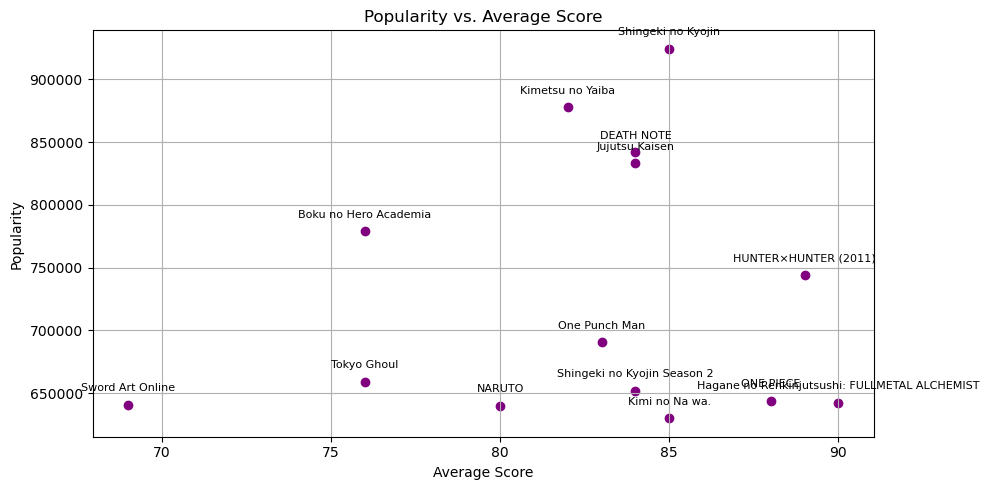

In [19]:
import matplotlib.pyplot as plt

# Plot average score vs. popularity
scores = [entry['averageScore'] for entry in anime_data]
titles = [entry['title']['romaji'] for entry in anime_data]
popularity = [entry['popularity'] for entry in anime_data]

plt.figure(figsize=(10, 5))
# Scatter plot: x = average score, y = popularity, with anime titles as text
plt.scatter(scores, popularity, color='purple')

for x, y, title in zip(scores, popularity, titles):
    plt.text(x, y + max(popularity) * 0.01, title, ha='center', va='bottom', fontsize=8, rotation=0)

plt.title('Popularity vs. Average Score')
plt.xlabel('Average Score')
plt.ylabel('Popularity')
plt.grid(True)
plt.tight_layout()
plt.show()


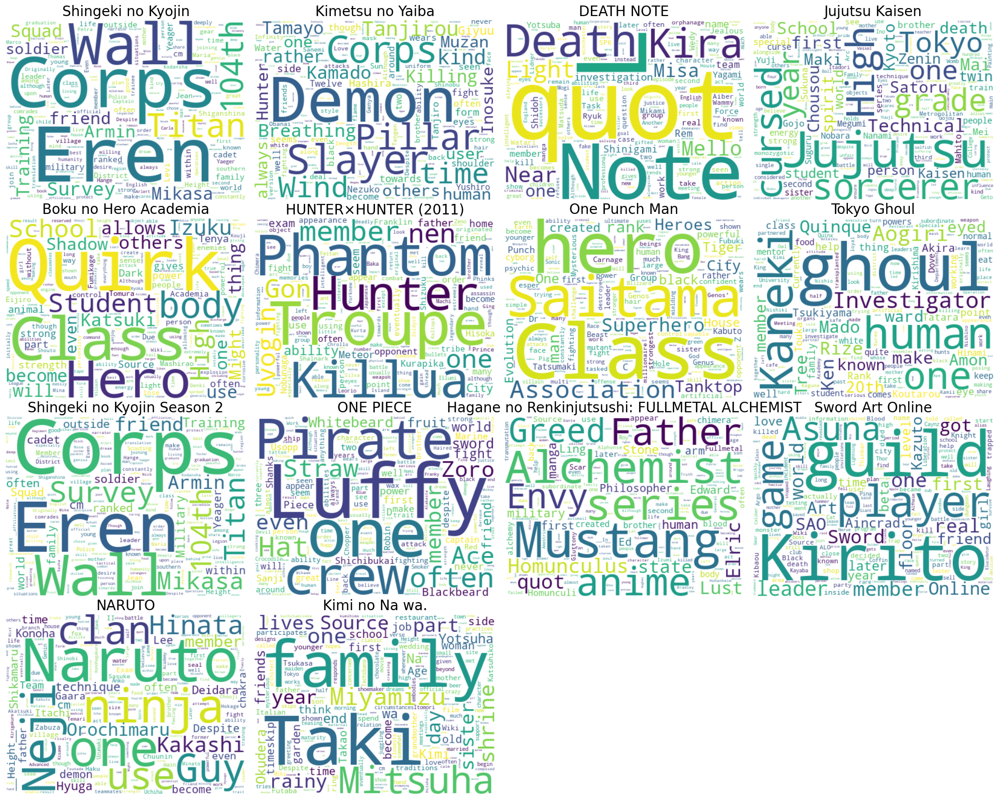

In [20]:
from wordcloud import WordCloud, STOPWORDS

import matplotlib.pyplot as plt

# Prepare stopwords
stopwords = set(STOPWORDS)
stopwords.update(['br', 'n', 's', 'u', 'li', 'ul', 'i', 'b', 'p', 'span'])

# Collect character descriptions for each anime
desc_lists = []
for entry in anime_data:
    descs = []
    for char in entry.get('characters', []):
        desc = char.get('description', '')
        if desc:
            descs.append(desc)
    desc_lists.append(' '.join(descs))

# Plot word clouds in subplots (4 columns)
n = len(anime_data)
cols = 4
rows = (n + cols - 1) // cols
fig, axes = plt.subplots(rows, cols, figsize=(cols*5, rows*4))

for idx, (desc, entry) in enumerate(zip(desc_lists, anime_data)):
    row, col = divmod(idx, cols)
    ax = axes[row, col] if rows > 1 else axes[col]
    wc = WordCloud(width=400, height=300, background_color='white', stopwords=stopwords, collocations=False).generate(desc)
    ax.imshow(wc, interpolation='bilinear')
    ax.set_title(entry['title']['romaji'], fontsize=20)
    ax.axis('off')

# Hide unused subplots
for idx in range(n, rows*cols):
    row, col = divmod(idx, cols)
    ax = axes[row, col] if rows > 1 else axes[col]
    ax.axis('off')

plt.tight_layout()
plt.show()

In [21]:
from collections import Counter, defaultdict

# Count how many characters have each attribute, and how many animes have at least one character with that attribute
attribute_counter = Counter()
anime_attribute_counter = Counter()

for entry in anime_data:
    seen_attrs = set()
    for char in entry.get('characters', []):
        attrs = char.get('attributes', {})
        for attr in attrs:
            attribute_counter[attr] += 1
            seen_attrs.add(attr)
    for attr in seen_attrs:
        anime_attribute_counter[attr] += 1

# List of (attribute, character_count, anime_count)
attribute_stats = [
    (attr, attribute_counter[attr], anime_attribute_counter[attr])
    for attr in attribute_counter
]

# Sort by character count descending
attribute_stats.sort(key=lambda x: x[1], reverse=True)

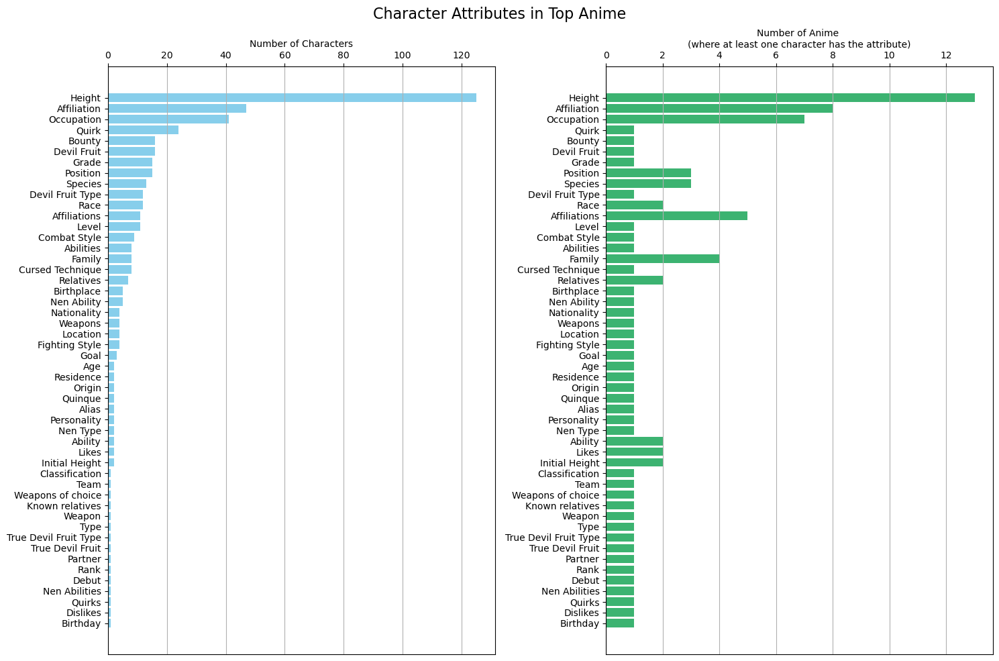

In [22]:
import matplotlib.pyplot as plt

# Prepare data for both plots
# Sort by character count descending
sorted_stats = sorted(attribute_stats, key=lambda x: x[1], reverse=False)
attr_names = [attr for attr, char_count, anime_count in sorted_stats]
char_counts = [char_count for attr, char_count, anime_count in sorted_stats]
anime_counts = [anime_count for attr, char_count, anime_count in sorted_stats]

plt.figure(figsize=(15, 10))
plt.suptitle('Character Attributes in Top Anime', fontsize=16)
# Plot 1: Character counts (horizontal bar)
plt.subplot(1, 2, 1)
plt.barh(attr_names, char_counts, color='skyblue')
plt.xlabel('Number of Characters')
plt.grid(axis='x')
plt.gca().xaxis.set_label_position('top')
plt.gca().xaxis.tick_top()
plt.yticks(rotation=0)

# Plot 2: Anime counts (horizontal bar)
plt.subplot(1, 2, 2)
plt.barh(attr_names, anime_counts, color='mediumseagreen')
plt.xlabel('Number of Anime \n(where at least one character has the attribute)')
plt.grid(axis='x')
plt.gca().xaxis.set_label_position('top')
plt.gca().xaxis.tick_top()
plt.yticks(rotation=0)

plt.tight_layout()
plt.show()

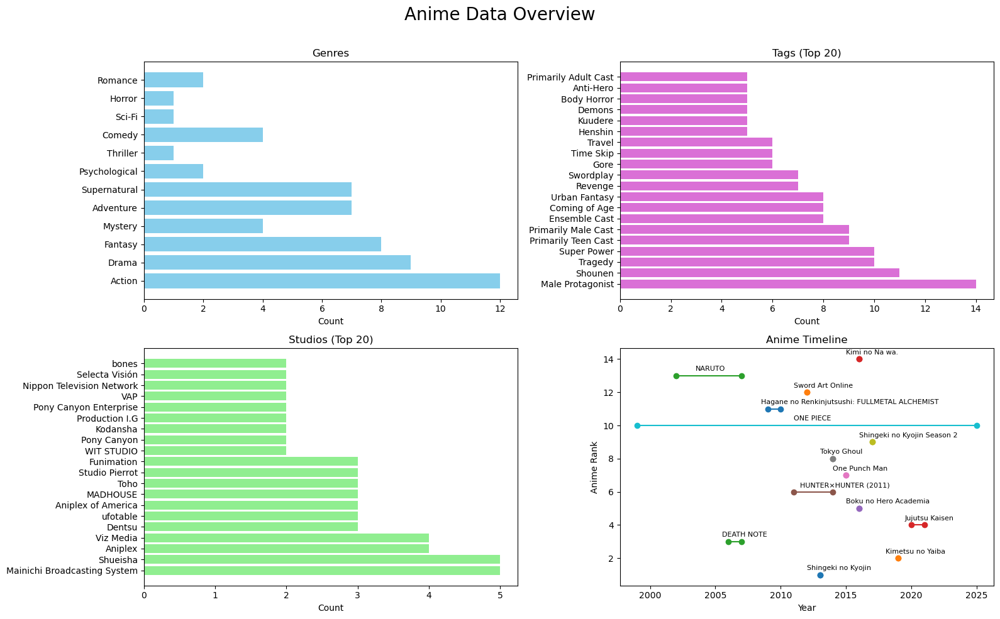

In [23]:
from collections import Counter
import datetime

import matplotlib.pyplot as plt

# Genres
all_genres = [genre for entry in anime_data for genre in entry.get('genres', [])]
genre_counts = Counter(all_genres)

# Tags
all_tags = [tag for entry in anime_data for tag in entry.get('tags', [])]
tag_counts = Counter(all_tags)

# Studios
all_studios = [studio for entry in anime_data for studio in entry.get('studios', [])]
studio_counts = Counter(all_studios)

# Start Dates (by year)
start_years = [entry['startDate']['year'] for entry in anime_data if entry.get('startDate', {}).get('year')]
start_year_counts = Counter(start_years)

# End Dates (by year)
end_years = [entry['endDate']['year'] for entry in anime_data if entry.get('endDate', {}).get('year')]
end_year_counts = Counter(end_years)

fig, axes = plt.subplots(2, 2, figsize=(16, 10))
fig.suptitle('Anime Data Overview', fontsize=20)

# Genres
axes[0, 0].barh(list(genre_counts.keys()), list(genre_counts.values()), color='skyblue')
axes[0, 0].set_title('Genres')
axes[0, 0].set_xlabel('Count')

# Tags (show top 20)
top_tags = tag_counts.most_common(20)
axes[0, 1].barh([t[0] for t in top_tags], [t[1] for t in top_tags], color='orchid')
axes[0, 1].set_title('Tags (Top 20)')
axes[0, 1].set_xlabel('Count')

# Studios (show top 20)
top_studios = studio_counts.most_common(20)
axes[1, 0].barh([s[0] for s in top_studios], [s[1] for s in top_studios], color='lightgreen')
axes[1, 0].set_title('Studios (Top 20)')
axes[1, 0].set_xlabel('Count')

# Timeline plot: Each anime as a horizontal line from start to end year, with title label
current_year = datetime.datetime.now().year
for entry in anime_data:
    start_year = entry.get('startDate', {}).get('year')
    end_year = entry.get('endDate', {}).get('year') or datetime.datetime.now().year
    if start_year and end_year:
        axes[1, 1].plot([start_year, end_year], [entry['rank'], entry['rank']], marker='o')
        axes[1, 1].text(start_year + (end_year-start_year)/2 - 1.0, entry['rank']+0.4, entry['title']['romaji'], fontsize=8, verticalalignment='center')
    elif start_year:
        axes[1, 1].plot([start_year, current_year], [entry['rank'], entry['rank']], marker='o')
        axes[1, 1].text(start_year + (current_year-start_year)/2 - 1.0, entry['rank']+0.4, entry['title']['romaji'], fontsize=8, verticalalignment='center')
axes[1, 1].set_title('Anime Timeline')
axes[1, 1].set_xlabel('Year')
axes[1, 1].set_ylabel('Anime Rank') 

plt.tight_layout(rect=[0, 0, 1, 0.97])
plt.show()

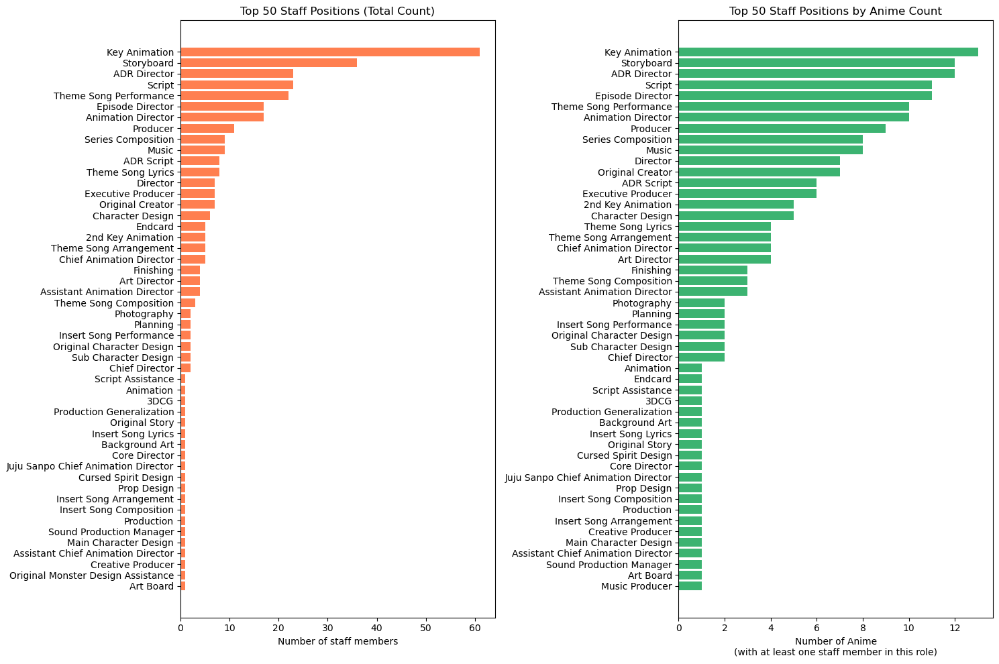

In [24]:
from collections import Counter

import matplotlib.pyplot as plt

# Count occurrences of each staff role
all_staff_roles = [staff['role'] for entry in anime_data for staff in entry.get('staff', [])]
staff_role_counts = Counter(all_staff_roles)
top_roles = staff_role_counts.most_common(50)

# Count how many animes have at least one staff for each role
anime_staff_role_counter = Counter()
for entry in anime_data:
    seen_roles = set()
    for staff in entry.get('staff', []):
        role = staff.get('role')
        if role:
            seen_roles.add(role)
    for role in seen_roles:
        anime_staff_role_counter[role] += 1

# Get top 50 roles by anime count
top_roles_by_anime = anime_staff_role_counter.most_common(50)

# Plot both as subplots
fig, axes = plt.subplots(1, 2, figsize=(15, 10))

# Bar plot for top 50 staff roles (total count)
axes[0].barh([role for role, count in reversed(top_roles)], [count for role, count in reversed(top_roles)], color='coral')
axes[0].set_xlabel('Number of staff members')
axes[0].set_title('Top 50 Staff Positions (Total Count)')

# Bar plot for top 50 staff roles by anime count
axes[1].barh([role for role, count in reversed(top_roles_by_anime)], [count for role, count in reversed(top_roles_by_anime)], color='mediumseagreen')
axes[1].set_xlabel('Number of Anime\n(with at least one staff member in this role)')
axes[1].set_title('Top 50 Staff Positions by Anime Count')

plt.tight_layout()
plt.show()
